# Aim of the notebook

In this notebook we compare the performance of the different domain finder algorithms, applied to the mouse brain ROI in 7.1, to the manually annotated region

## Import packages

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn.metrics as sk
import os
import json
from shapely.geometry import Point, Polygon
import random
import matplotlib
from xb.plotting import generate_hex_colors
from xb.calculating import compute_nmi,entropy,compute_vi,compute_fmi

# Read data and define paths

In [3]:
saving_path=r'/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/data/processed_adata/'
adata=sc.read('/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/data/processed_adata/adata_multisection_nuclei_r1_with_annotations.h5ad')
adata=adata[adata.obs['replicate']=='1']
adata.X=adata.layers['raw']
adata.obsm['spatial']=np.array(adata.obs.loc[:,['x_centroid','y_centroid']])

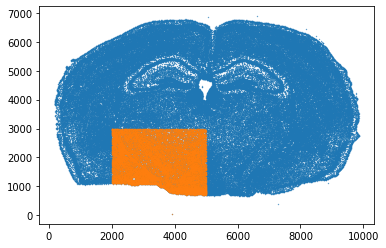

In [4]:
adata2=adata[(adata.obs['x_centroid']<5000)&(adata.obs['x_centroid']>2000)&(adata.obs['y_centroid']<3000)]
plt.scatter(adata.obs.loc[:,'x_centroid'],adata.obs.loc[:,'y_centroid'],s=0.1)
plt.scatter(adata2.obs.loc[:,'x_centroid'],adata2.obs.loc[:,'y_centroid'],s=0.1)
adata=adata2
ndoms=[]
for num in range(1,5):
    ndoms.append(len(np.unique(adata.obs['region_level'+str(num)])))

In [5]:
adatar1=adata
regdict={'5':'region_level1','6':'region_level2','10':'region_level3','16':'region_level4'}
opts=['5','6','10','16']

In [6]:
### READ BORDERS AND GENERATE PALETTE
ob=open('/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/2.comparison_between_datasets/polygons/regions_multisection_1.json')
js=json.load(ob)
output=pd.DataFrame(columns=['y','x','region_annotation','region_general'])
nu=0
for ob in js:
    for num in range(0,len(ob['coordinates'][0])):
        output.loc[nu,:]=list([ob['coordinates'][0][num][0],ob['coordinates'][0][num][1],ob['name'],ob['name'].replace(' [1]','').replace('D: ','')])
        nu=nu+1      
dictio_region=dict(zip(output['region_annotation'],output['region_general']))
dictio_region['D: vl [2]']='vl'
# Example usage:
colors = generate_hex_colors()

## Next, we read the domains predicted by each of the methods

0
                REF
method             
AGGSIGNAL  0.377568
BANKSY     0.459958
NEIGHBORS  0.334114
SPACEL     0.584344
STAGATE    0.353943
SpaGCN     0.239688
deepST     0.180206


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:68: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


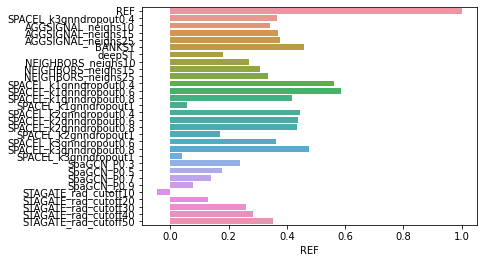

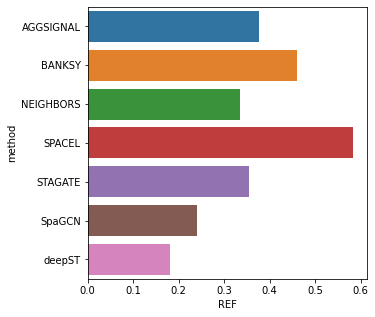

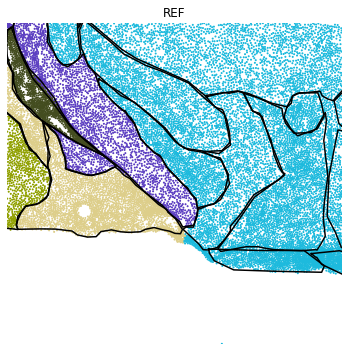

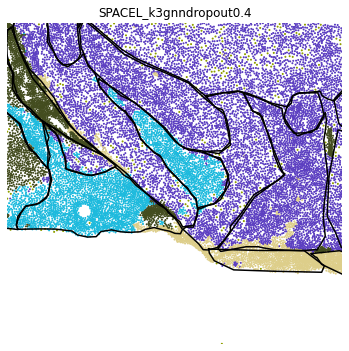

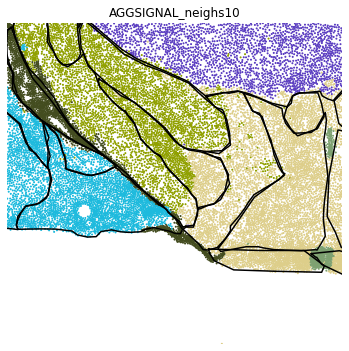

...

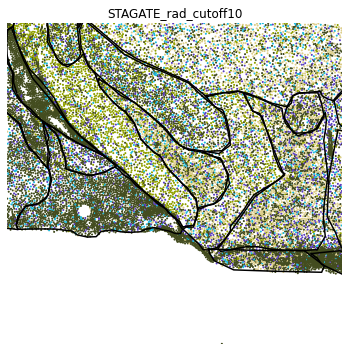

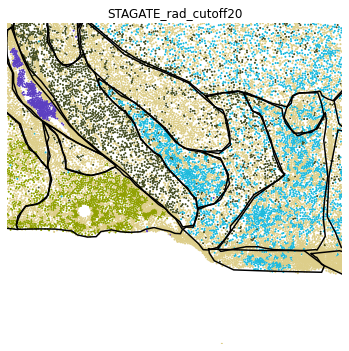

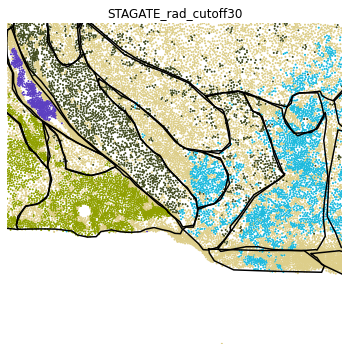

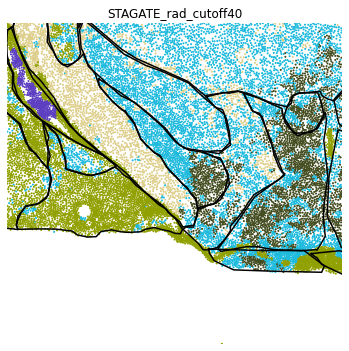

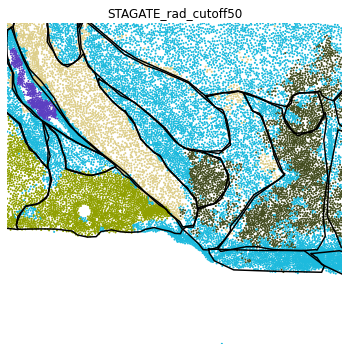

1
                REF
method             
AGGSIGNAL  0.517348
BANKSY     0.623451
NEIGHBORS  0.463669
SPACEL     0.295139
STAGATE    0.268752
SpaGCN     0.309885
deepST     0.268329


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:68: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


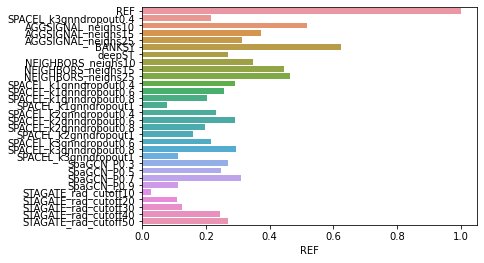

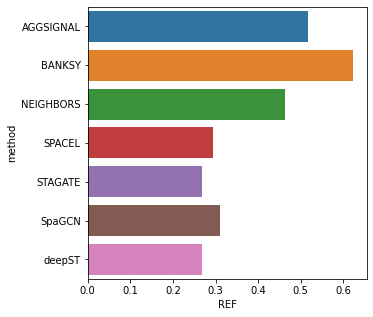

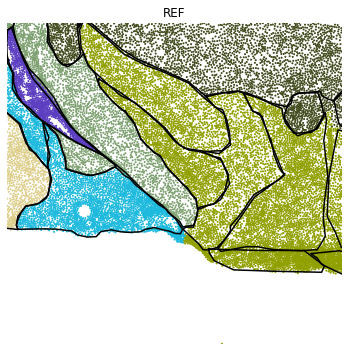

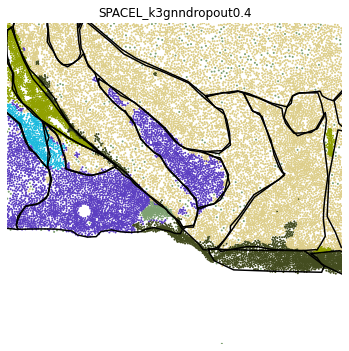

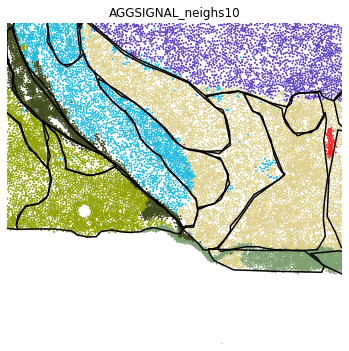

...

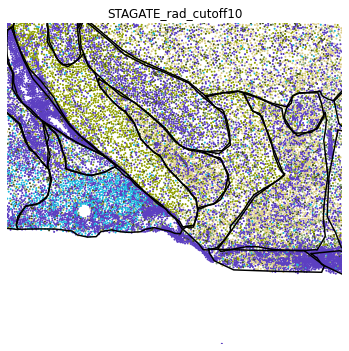

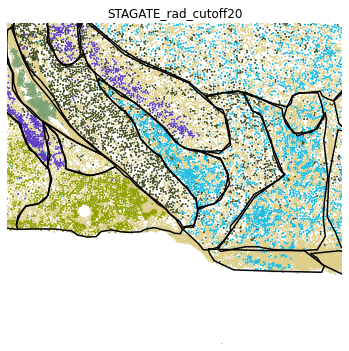

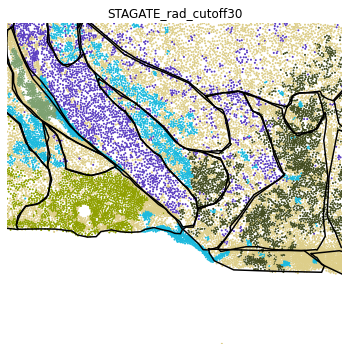

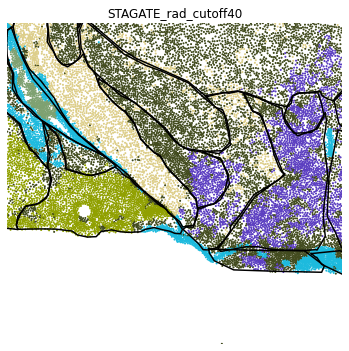

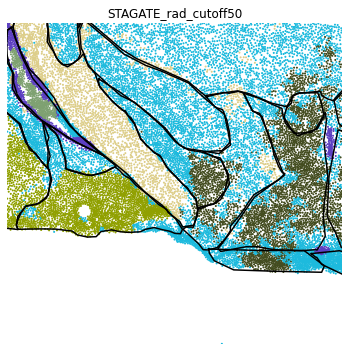

2
                REF
method             
AGGSIGNAL  0.578715
BANKSY     0.463001
NEIGHBORS  0.507099
SPACEL     0.376545
STAGATE    0.350096
SpaGCN     0.243699
deepST     0.254514


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:68: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


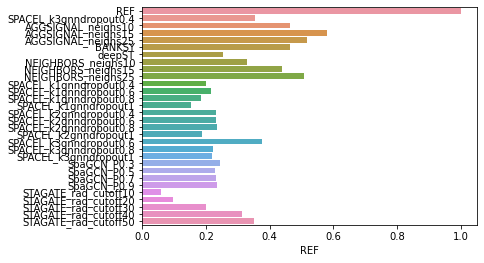

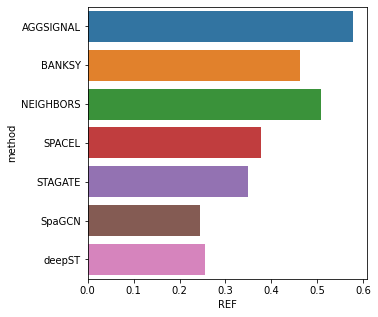

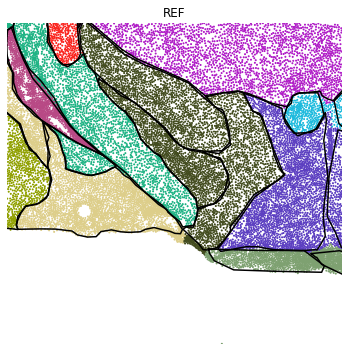

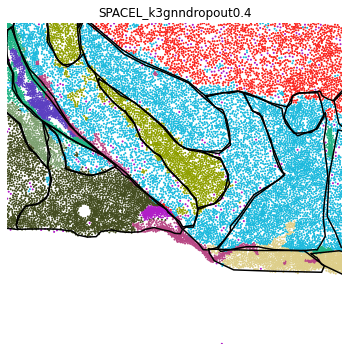

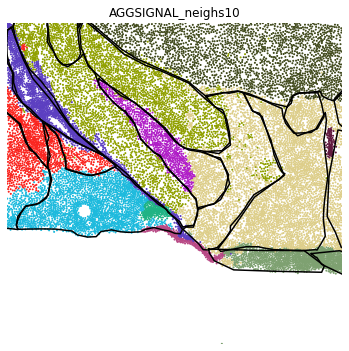

...

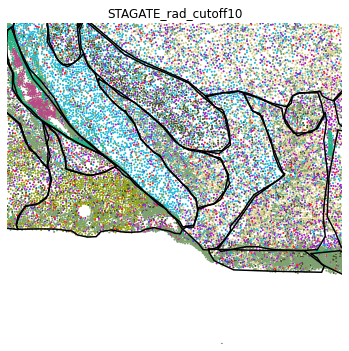

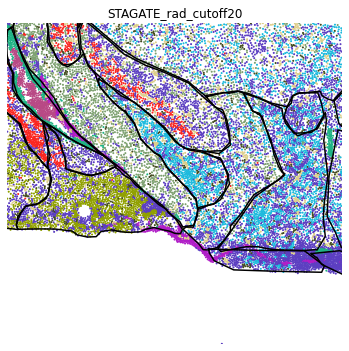

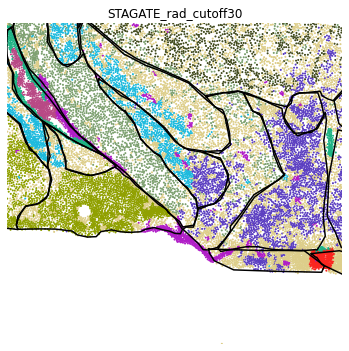

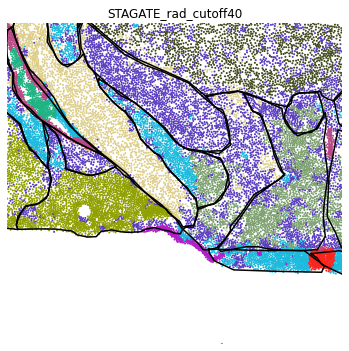

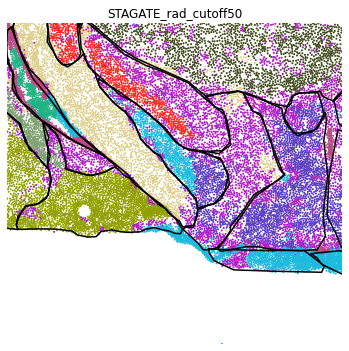

3
                REF
method             
AGGSIGNAL  0.536498
BANKSY     0.502772
NEIGHBORS  0.627307
SPACEL     0.554024
STAGATE    0.359428
SpaGCN     0.288202
deepST     0.309401


/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:68: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


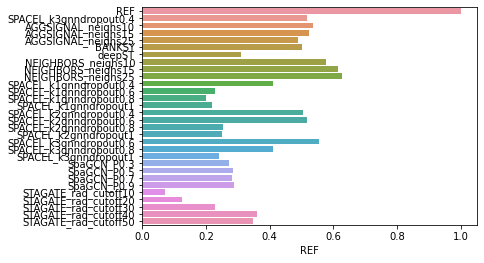

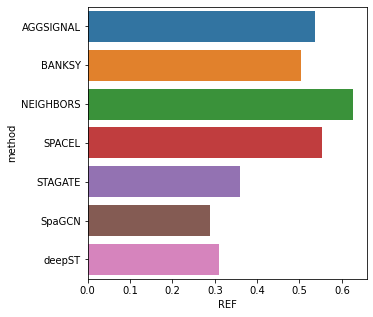

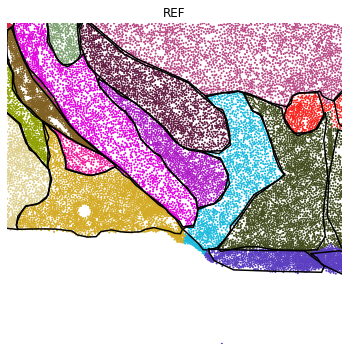

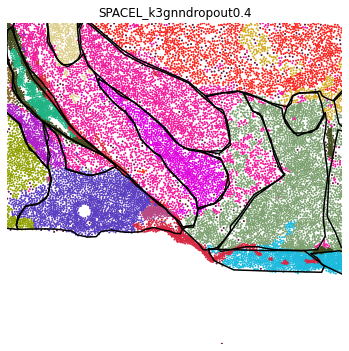

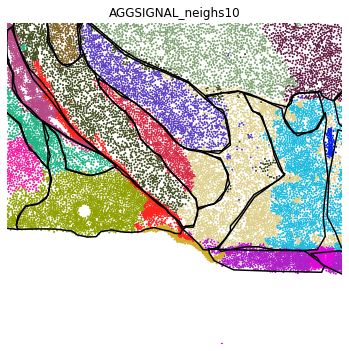

...

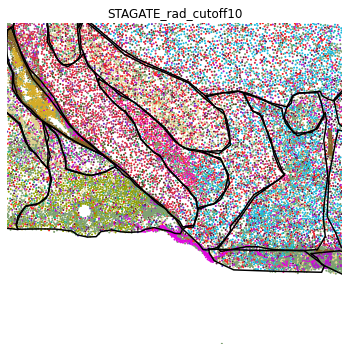

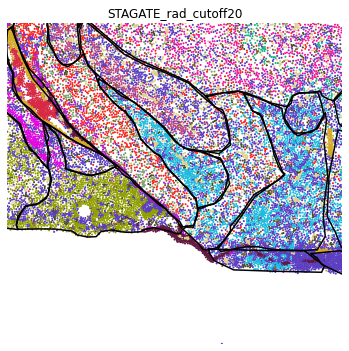

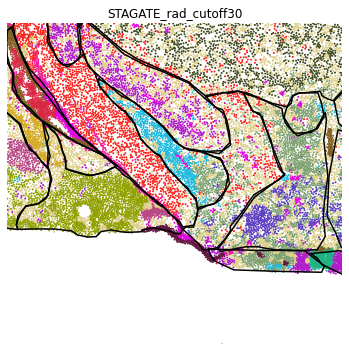

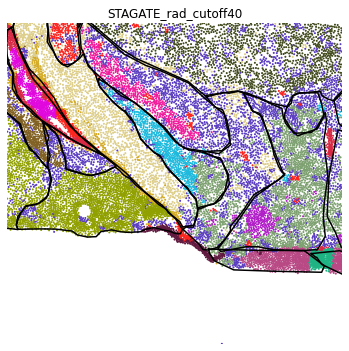

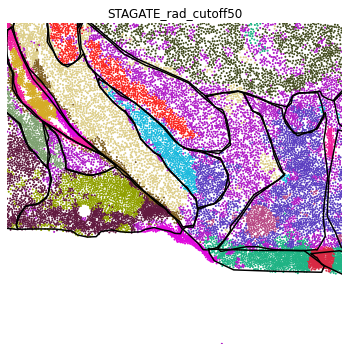

In [9]:
maxscores=[]
for i in range(0,len(opts)):

        print(i)
        path='/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/7.spatial_architecture/domains_predicted/ROI2/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=sk.adjusted_rand_score(results[ind],results[col])
        
        import matplotlib
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/ari_between_domain_tools_barplot_'+str(opts[i])+'_ALL_ROI2.pdf')
        
        import matplotlib
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        ARI_topperf=ARI_with_main.groupby('method').max()
        print(ARI_topperf)
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/ari_between_domain_tools_barplot_'+str(opts[i])+'_MAX_ROI2.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)
        ##
        for num in range(0,results.shape[1]):
            usedclust=results.iloc[:,num]
            uniquecls=np.unique(usedclust)
            coldict=dict(zip(np.unique(uniquecls),colors))

            dim1=(np.max(adata.obs['x_centroid'])-np.min(adata.obs['x_centroid']))/500
            dim2=(np.max(adata.obs['y_centroid'])-np.min(adata.obs['y_centroid']))/500
            plt.figure(figsize=(dim1,dim2))
            plt.scatter(x=adata.obs['x_centroid'],y=adata.obs['y_centroid'],s=1,c=usedclust.map(coldict))
            plsin=output
            plsin['yc']=plsin['x']*0.2125
            plsin['xc']=plsin['y']*0.2125
            from shapely.geometry import Point, Polygon
            for sel in plsin['region_annotation'].unique():
                    plsub=plsin[plsin['region_annotation']==sel]
                    if plsub.shape[0]>2:
                #        plt.figure()
                        coord = np.array(plsub[['yc','xc']]).tolist()
                        coord.append(coord[0])
                        poli=Polygon(coord)
                        xs, ys = zip(*coord) #create lists of x and y values
                        plt.plot(xs,ys,color='black') 
            plt.xlim(np.min(adata.obs['x_centroid']),np.max(adata.obs['x_centroid']))
            plt.ylim(np.min(adata.obs['y_centroid']),np.max(adata.obs['y_centroid']))
            plt.axis('off')
            plt.title(results.columns[num])
            plt.savefig('../../figures/7.spatial_architecture/domains/spatial_maps/'+str(results.columns[num])+'_'+str(opts[i])+'_ROI2.png') 
        plt.show() # if you need...

# 

# Plot the ARI for each method 

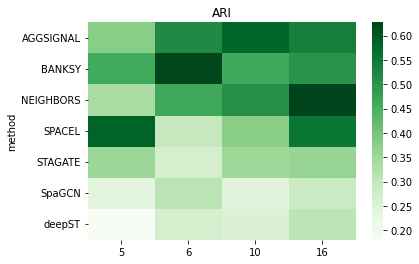

In [25]:
allscores_ARI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_ARI,cmap='Greens')
plt.title('ARI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_ARI_ROI2.pdf')

# Plot the ARI_RANKED

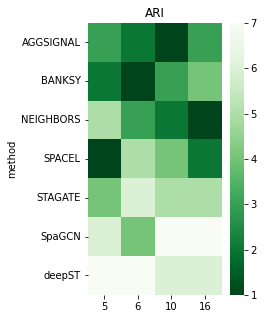

In [26]:
allscores_ARI_ranked=allscores_ARI.rank(axis=0,ascending=False)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_ARI_ranked,cmap=matplotlib.cm.get_cmap('Greens_r'))
plt.title('ARI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_ARI_ROI2_ranked.pdf')

# 2. Now we do the same of NMI

0
1
2
3


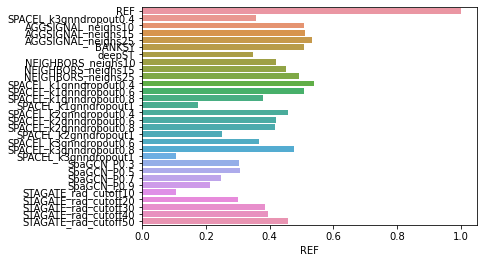

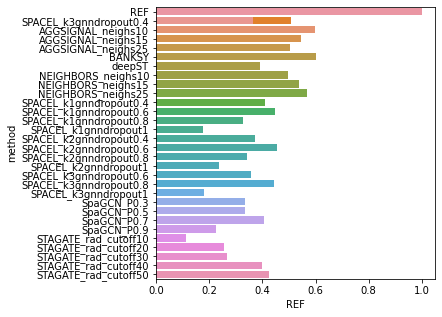

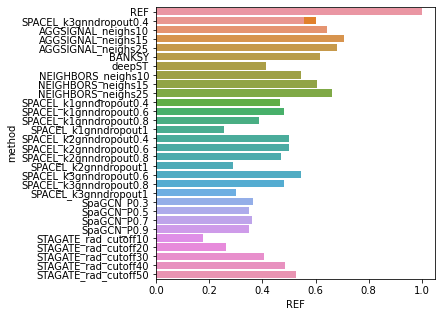

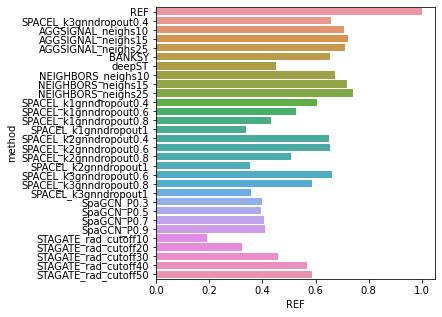

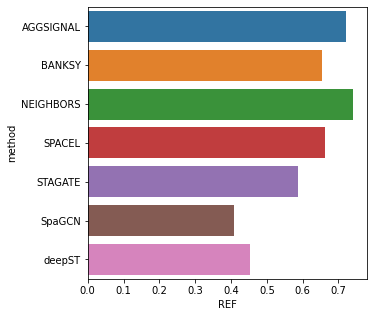

In [27]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/7.spatial_architecture/domains_predicted/ROI2/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_nmi(results[ind],results[col])
        
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/nmi_between_domain_tools_barplot_'+str(opts[i])+'_ALL_ROI2.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        ARI_topperf=ARI_with_main.groupby('method').max()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/nmi_between_domain_tools_barplot_'+str(opts[i])+'_MAX_ROI2.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

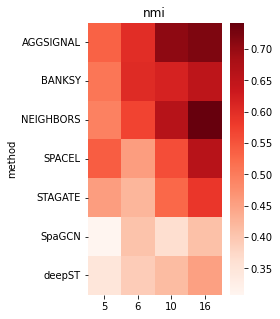

In [28]:
plt.figure(figsize=(3,5))
allscores_nmi=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_nmi,cmap='Reds')
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_NMI_ROI2.pdf')

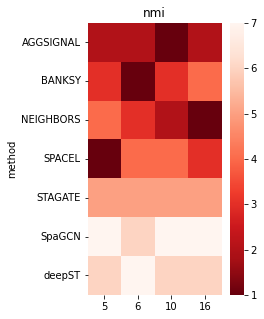

In [29]:
allscores_nmi_ranked=allscores_nmi.rank(axis=0,ascending=False)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_nmi_ranked,cmap=matplotlib.cm.get_cmap('Reds_r'))
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_NMI_ROI2_ranked.pdf')

# 2. Now we do the same of VI

0
1
2
3


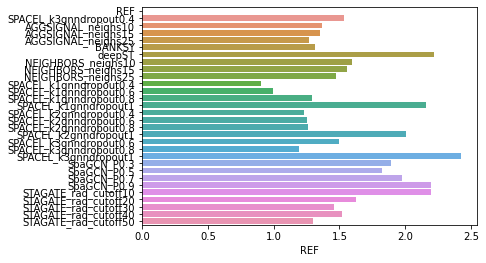

<Figure size 360x360 with 0 Axes>

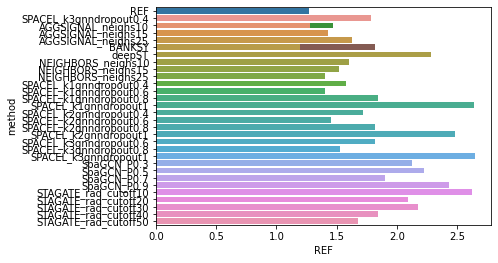

<Figure size 360x360 with 0 Axes>

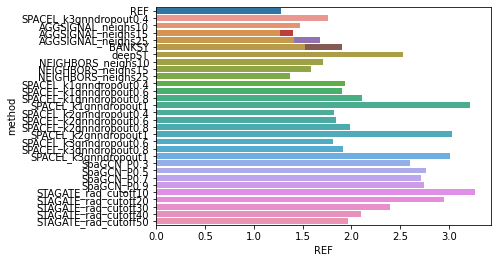

<Figure size 360x360 with 0 Axes>

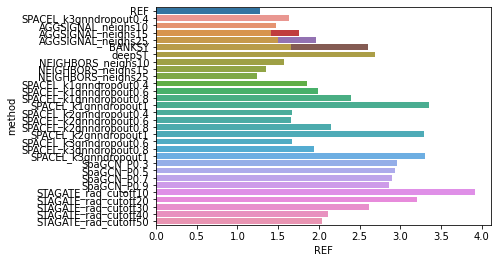

<Figure size 360x360 with 0 Axes>

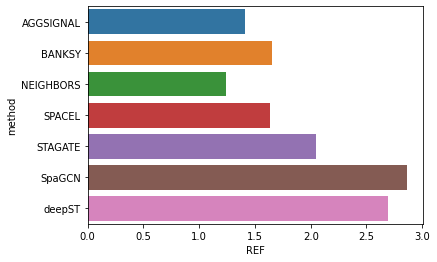

In [39]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/7.spatial_architecture/domains_predicted/ROI2/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_vi(results[ind],results[col])
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_ALL_ROI2.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        plt.figure()
        ARI_topperf=ARI_with_main.groupby('method').min()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_MAX_ROI2.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

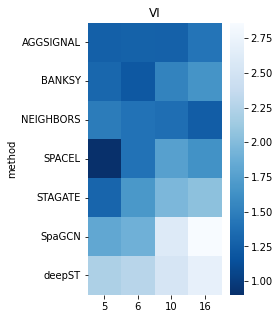

In [40]:
plt.figure(figsize=(3,5))
allscores_VI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_VI,cmap=matplotlib.cm.get_cmap('Blues_r'))
plt.title('VI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_VI_ROI2.pdf')

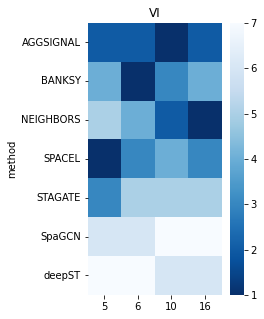

In [41]:
allscores_VI_ranked=allscores_VI.rank(axis=0,ascending=True)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_VI_ranked,cmap=matplotlib.cm.get_cmap('Blues_r'))
plt.title('VI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_VI_ROI2_ranked.pdf')

# 2. Now we do the same of FMI

0
1
2
3


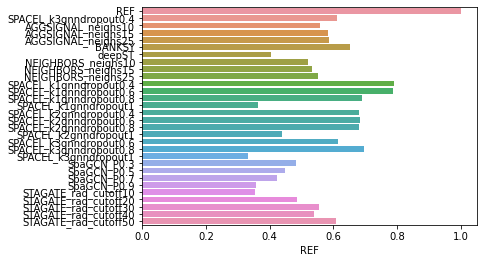

<Figure size 360x360 with 0 Axes>

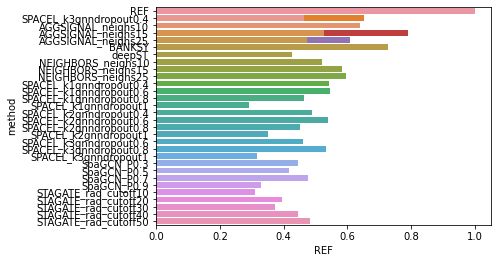

<Figure size 360x360 with 0 Axes>

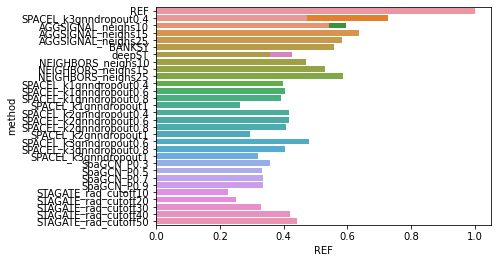

<Figure size 360x360 with 0 Axes>

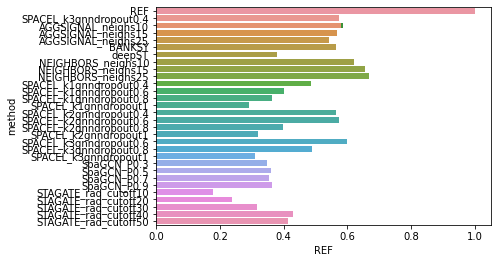

<Figure size 360x360 with 0 Axes>

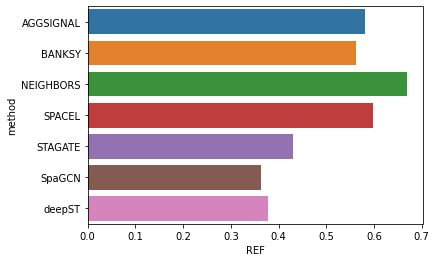

In [36]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/7.spatial_architecture/domains_predicted/ROI2/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
            allres.append(sumary)

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_fmi(results[ind],results[col])
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/fmi_between_domain_tools_barplot_'+str(opts[i])+'_ALL_ROI2.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        plt.figure()
        ARI_topperf=ARI_with_main.groupby('method').max()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/fmi_between_domain_tools_barplot_'+str(opts[i])+'_MAX_ROI2.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

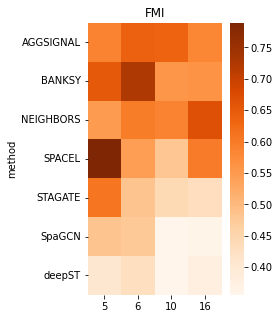

In [37]:
plt.figure(figsize=(3,5))
allscores_FMI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_FMI,cmap=matplotlib.cm.get_cmap('Oranges'))
plt.title('FMI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_FMI_ROI2.pdf')

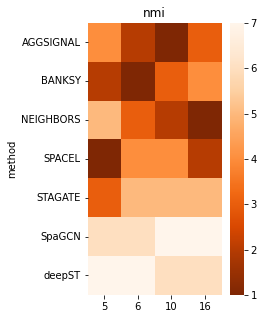

In [38]:
allscores_FMI_ranked=allscores_FMI.rank(axis=0,ascending=False)
plt.figure(figsize=(3,5))
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_FMI_ranked,cmap=matplotlib.cm.get_cmap('Oranges_r'))
plt.title('nmi')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_FMI_ROI2_ranked.pdf')

# aggreg

0
1
2
3


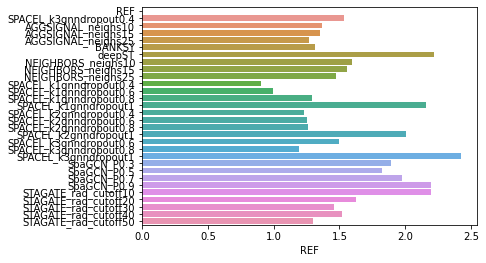

<Figure size 360x360 with 0 Axes>

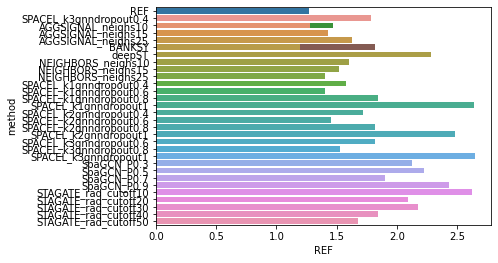

<Figure size 360x360 with 0 Axes>

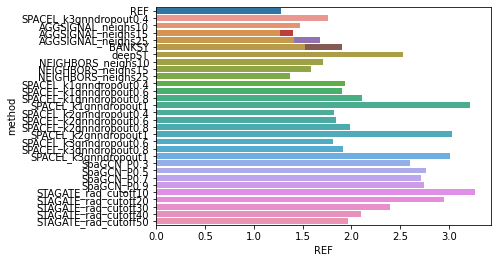

<Figure size 360x360 with 0 Axes>

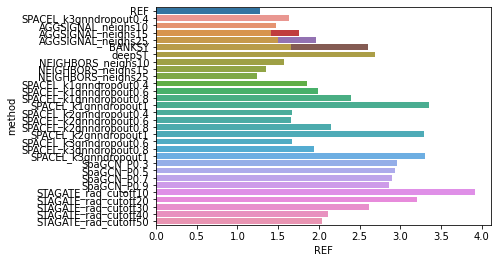

<Figure size 360x360 with 0 Axes>

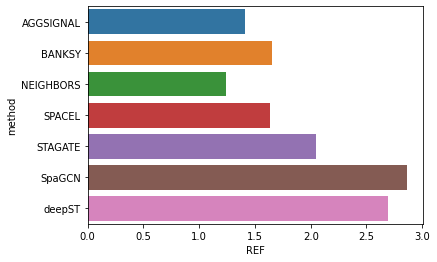

In [34]:
maxscores=[]
for i in range(0,len(opts)):
        print(i)
        path='/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/figures/7.spatial_architecture/domains_predicted/ROI2/'
        pn=path+opts[i]
        files=os.listdir(pn)
        allres=[]
        resi=pd.DataFrame(list(adatar1.obs[regdict[opts[i]]]),index=adatar1.obs['cell_id'])
        resi.columns=['REF']
        allres.append(resi)
    #    print(resi.shape)
        for f in files:
            fil=pd.read_csv(pn+'/'+f)
            try:
                sumary=fil.loc[:,['spatial_domain']]
                sumary.index=fil['cell_id']
            except:
                sumary=fil.loc[:,['mclust']]
                sumary.index=fil['cell_id']
            sumary.columns=[f]
    #        sumary.index=sumary.index.astype(str)
            #sumary=sumary.reset_index()
            #sumary=sumary.iloc[:,1:2]
          #  print(len(np.unique(sumary.index)))
            allres.append(sumary)
        #resi=resi.reset_index()
        #resi=resi.iloc[:,1:2]

        results=pd.concat(allres,axis=1)
        results.columns=[col.replace('predicted_','').replace('.csv','') for col in results.columns]
        ARI=pd.DataFrame(index=results.columns,columns=results.columns)
        for ind in ARI.index:
            for col in ARI.columns:
                ARI.loc[ind,col]=compute_vi(results[ind],results[col])
        matplotlib.rcParams['pdf.fonttype'] = 42
        matplotlib.rcParams['ps.fonttype'] = 42
        sns.barplot(y=ARI.index,x=ARI.loc['REF',:])
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_ALL_ROI2.pdf')
        plt.figure(figsize=(5,5))
        ARI_with_main=ARI.loc[~ARI.index.isin(['REF']),['REF']]
        method=[]
        for indi in ARI_with_main.index:
            method.append(indi.split('_')[0])
        ARI_with_main['method']=method
        plt.figure()
        ARI_topperf=ARI_with_main.groupby('method').min()
        sns.barplot(x=ARI_topperf['REF'],y=ARI_topperf.index)
        plt.savefig('../../figures/7.spatial_architecture/domains/VI_between_domain_tools_barplot_'+str(opts[i])+'_MAX_ROI2.pdf')
        ARI_topperf.columns=[opts[i]]
        maxscores.append(ARI_topperf)

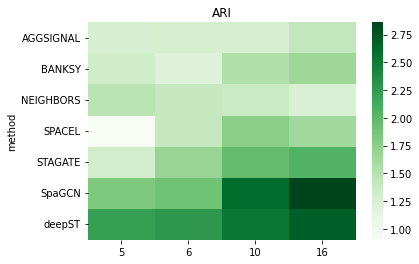

In [35]:
allscores_ARI=pd.concat(maxscores,axis=1)
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
sns.heatmap(allscores_ARI,cmap='Greens')
plt.title('ARI')
plt.savefig('../../figures/7.spatial_architecture/domains/ALL_ARI_ROI2.pdf')

<AxesSubplot:>

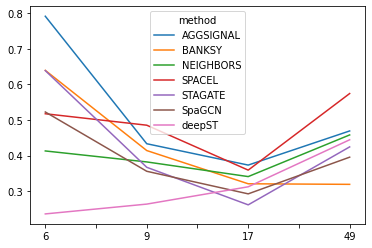

In [128]:
allscores_ARI.transpose().plot()